In [3]:
## Set tf ENV. 
import os
os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"   
os.environ["CUDA_VISIBLE_DEVICES"]="0"

In [4]:
import tensorflow as tf
import glob
from typing import Callable, Dict, List, Optional
from absl import logging
import gin.tf

In [5]:
def _create_feature_map() -> Dict[str, tf.io.FixedLenFeature]:
  """Creates the feature map for extracting the frame triplet."""
  feature_map = {
      'frame_0/encoded':
          tf.io.FixedLenFeature((), tf.string, default_value=''),
      'frame_0/format':
          tf.io.FixedLenFeature((), tf.string, default_value='jpg'),
      'frame_0/height':
          tf.io.FixedLenFeature((), tf.int64, default_value=0),
      'frame_0/width':
          tf.io.FixedLenFeature((), tf.int64, default_value=0),
      'frame_1/encoded':
          tf.io.FixedLenFeature((), tf.string, default_value=''),
      'frame_1/format':
          tf.io.FixedLenFeature((), tf.string, default_value='jpg'),
      'frame_1/height':
          tf.io.FixedLenFeature((), tf.int64, default_value=0),
      'frame_1/width':
          tf.io.FixedLenFeature((), tf.int64, default_value=0),
      'frame_2/encoded':
          tf.io.FixedLenFeature((), tf.string, default_value=''),
      'frame_2/format':
          tf.io.FixedLenFeature((), tf.string, default_value='jpg'),
      'frame_2/height':
          tf.io.FixedLenFeature((), tf.int64, default_value=0),
      'frame_2/width':
          tf.io.FixedLenFeature((), tf.int64, default_value=0),
      'path':
          tf.io.FixedLenFeature((), tf.string, default_value=''),
  }
  return feature_map


def _parse_example(sample):
  """Parses a serialized sample.

  Args:
    sample: A serialized tf.Example to be parsed.

  Returns:
    dictionary containing the following:
      encoded_image
      image_height
      image_width
  """
  feature_map = _create_feature_map()
  features = tf.io.parse_single_example(sample, feature_map)
  output_dict = {
      'x0': tf.io.decode_image(features['frame_0/encoded'], dtype=tf.float32),
      'x1': tf.io.decode_image(features['frame_2/encoded'], dtype=tf.float32),
      'y': tf.io.decode_image(features['frame_1/encoded'], dtype=tf.float32),
      # The fractional time value of frame_1 is not included in our tfrecords,
      # but is always at 0.5. The model will expect this to be specificed, so
      # we insert it here.
      'time': 0.5,
      # Store the original mid frame filepath for identifying examples.
      'path': features['path'],
  }

  return output_dict


def _random_crop_images(crop_size: int, images: tf.Tensor,
                        total_channel_size: int) -> tf.Tensor:
  """Crops the tensor with random offset to the given size."""
  if crop_size > 0:
    crop_shape = tf.constant([crop_size, crop_size, total_channel_size])
    images = tf.image.random_crop(images, crop_shape)
  return images


def crop_example(example: tf.Tensor, crop_size: int,
                 crop_keys: Optional[List[str]] = None):
  """Random crops selected images in the example to given size and keys.

  Args:
    example: Input tensor representing images to be cropped.
    crop_size: The size to crop images to. This value is used for both
      height and width.
    crop_keys: The images in the input example to crop.

  Returns:
    Example with cropping applied to selected images.
  """
  if crop_keys is None:
    crop_keys = ['x0', 'x1', 'y']
    channels = [3, 3, 3]

  # Stack images along channel axis, and perform a random crop once.
  image_to_crop = [example[key] for key in crop_keys]
  stacked_images = tf.concat(image_to_crop, axis=-1)
  cropped_images = _random_crop_images(crop_size, stacked_images, sum(channels))
  cropped_images = tf.split(
      cropped_images, num_or_size_splits=channels, axis=-1)
  for key, cropped_image in zip(crop_keys, cropped_images):
    example[key] = cropped_image
  return example


def apply_data_augmentation(
    augmentation_fns: Dict[str, Callable[..., tf.Tensor]],
    example: tf.Tensor,
    augmentation_keys: Optional[List[str]] = None) -> tf.Tensor:
  """Applies random augmentation in succession to selected image keys.

  Args:
    augmentation_fns: A Dict of Callables to data augmentation functions.
    example: Input tensor representing images to be augmented.
    augmentation_keys: The images in the input example to augment.

  Returns:
    Example with augmentation applied to selected images.
  """
  if augmentation_keys is None:
    augmentation_keys = ['x0', 'x1', 'y']

  # Apply each augmentation in sequence
  augmented_images = {key: example[key] for key in augmentation_keys}
  for augmentation_function in augmentation_fns.values():
    augmented_images = augmentation_function(augmented_images)

  for key in augmentation_keys:
    example[key] = augmented_images[key]
  return example


def _create_from_tfrecord(batch_size, file, augmentation_fns,
                          crop_size) -> tf.data.Dataset:
  """Creates a dataset from TFRecord."""
  dataset = tf.data.TFRecordDataset(file)
  dataset = dataset.map(
      _parse_example, num_parallel_calls=tf.data.experimental.AUTOTUNE)

  # Perform data_augmentation before cropping and batching
  if augmentation_fns is not None:
    dataset = dataset.map(
        lambda x: apply_data_augmentation(augmentation_fns, x),
        num_parallel_calls=tf.data.experimental.AUTOTUNE)

  if crop_size > 0:
    dataset = dataset.map(
        lambda x: crop_example(x, crop_size=crop_size),
        num_parallel_calls=tf.data.experimental.AUTOTUNE)
  dataset = dataset.batch(batch_size, drop_remainder=True)
  return dataset


def _generate_sharded_filenames(filename: str) -> List[str]:
  """Generates filenames of the each file in the sharded filepath.

  Based on github.com/google/revisiting-self-supervised/blob/master/datasets.py.

  Args:
    filename: The sharded filepath.

  Returns:
    A list of filepaths for each file in the shard.
  """
  base, count = filename.split('@')
  count = int(count)
  return ['{}-{:05d}-of-{:05d}'.format(base, i, count) for i in range(count)]


def _create_from_sharded_tfrecord(batch_size,
                                  train_mode,
                                  file,
                                  augmentation_fns,
                                  crop_size,
                                  max_examples=-1) -> tf.data.Dataset:
  """Creates a dataset from a sharded tfrecord."""
  dataset = tf.data.Dataset.from_tensor_slices(
      _generate_sharded_filenames(file))

  # pylint: disable=g-long-lambda
  dataset = dataset.interleave(
      lambda x: _create_from_tfrecord(
          batch_size,
          file=x,
          augmentation_fns=augmentation_fns,
          crop_size=crop_size),
      num_parallel_calls=tf.data.AUTOTUNE,
      deterministic=not train_mode)
  # pylint: enable=g-long-lambda
  dataset = dataset.prefetch(buffer_size=2)
  if max_examples > 0:
    return dataset.take(max_examples)
  return dataset


@gin.configurable('training_dataset')
def create_training_dataset(
    batch_size: int,
    file: Optional[str] = None,
    files: Optional[List[str]] = None,
    crop_size: int = -1,
    crop_sizes: Optional[List[int]] = None,
    augmentation_fns: Optional[Dict[str, Callable[..., tf.Tensor]]] = None
) -> tf.data.Dataset:
  """Creates the training dataset.

  The given tfrecord should contain data in a format produced by
  frame_interpolation/datasets/create_*_tfrecord.py

  Args:
    batch_size: The number of images to batch per example.
    file: (deprecated) A path to a sharded tfrecord in <tfrecord>@N format.
      Deprecated. Use 'files' instead.
    files: A list of paths to sharded tfrecords in <tfrecord>@N format.
    crop_size: (deprecated) If > 0, images are cropped to crop_size x crop_size
      using tensorflow's random cropping. Deprecated: use 'files' and
      'crop_sizes' instead.
    crop_sizes: List of crop sizes. If > 0, images are cropped to
      crop_size x crop_size using tensorflow's random cropping.
    augmentation_fns: A Dict of Callables to data augmentation functions.
  Returns:
    A tensorflow dataset for accessing examples that contain the input images
    'x0', 'x1', ground truth 'y' and time of the ground truth 'time'=[0,1] in a
    dictionary of tensors.
  """
  if file:
    logging.warning('gin-configurable training_dataset.file is deprecated. '
                    'Use training_dataset.files instead.')
    return _create_from_sharded_tfrecord(batch_size, True, file,
                                         augmentation_fns, crop_size)
  else:
    if not crop_sizes or len(crop_sizes) != len(files):
      raise ValueError('Please pass crop_sizes[] with training_dataset.files.')
    if crop_size > 0:
      raise ValueError(
          'crop_size should not be used with files[], use crop_sizes[] instead.'
      )
    tables = []
    for file, crop_size in zip(files, crop_sizes):
      tables.append(
          _create_from_sharded_tfrecord(batch_size, True, file,
                                        augmentation_fns, crop_size))
    return tf.data.experimental.sample_from_datasets(tables)


@gin.configurable('eval_datasets')
def create_eval_datasets(batch_size: int,
                         files: List[str],
                         names: List[str],
                         crop_size: int = -1,
                         max_examples: int = -1) -> Dict[str, tf.data.Dataset]:
  """Creates the evaluation datasets.

  As opposed to create_training_dataset this function makes sure that the
  examples for each dataset are always read in a deterministic (same) order.

  Each given tfrecord should contain data in a format produced by
  frame_interpolation/datasets/create_*_tfrecord.py

  The (batch_size, crop_size, max_examples) are specified for all eval datasets.

  Args:
    batch_size: The number of images to batch per example.
    files: List of paths to a sharded tfrecord in <tfrecord>@N format.
    names: List of names of eval datasets.
    crop_size: If > 0, images are cropped to crop_size x crop_size using
      tensorflow's random cropping.
    max_examples: If > 0, truncate the dataset to 'max_examples' in length. This
      can be useful for speeding up evaluation loop in case the tfrecord for the
      evaluation set is very large.
  Returns:
    A dict of name to tensorflow dataset for accessing examples that contain the
    input images 'x0', 'x1', ground truth 'y' and time of the ground truth
    'time'=[0,1] in a dictionary of tensors.
  """
  return {
      name: _create_from_sharded_tfrecord(batch_size, False, file, None,
                                          crop_size, max_examples)
      for name, file in zip(names, files)
  }

In [6]:
@gin.configurable('data_augmentation')
def data_augmentations(
    names: List[str]) -> Dict[str, Callable[..., tf.Tensor]]:
  """Creates the data augmentation functions.

  Args:
    names: The list of augmentation function names.
  Returns:
    A dictionary of Callables to the augmentation functions, keyed by their
    names.
  """
  augmentations = dict()
  for name in names:
    if name == 'random_image_rot90':
      augmentations[name] = random_image_rot90
    elif name == 'random_rotate':
      augmentations[name] = random_rotate
    elif name == 'random_flip':
      augmentations[name] = random_flip
    elif name == 'random_reverse':
      augmentations[name] = random_reverse
    else:
      raise AttributeError('Invalid augmentation function %s' % name)
  return augmentations

---------------------------------------------------------------------------------------------------------------------

## Check:  DataLossError

In [7]:
# Read back one record to confirm:
import sys

occup = []
train_files = sorted(glob.glob('/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/*'))
for output_path in train_files:
#output_path = '/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00199-of-00200' 
    raw_dataset = tf.data.TFRecordDataset(output_path)
    print("raw_dataset", raw_dataset, file = sys.stderr )
    try:
        for raw_record in raw_dataset:
            example = tf.train.Example()
            example.ParseFromString(raw_record.numpy())
            #print("Reading back raw_record from", output_path, example)
    except Exception as e:
        occup.append(output_path)
        print("{} is corrupted".format(output_path))
        print(e)

raw_dataset <TFRecordDatasetV2 shapes: (), types: tf.string>
raw_dataset <TFRecordDatasetV2 shapes: (), types: tf.string>
raw_dataset <TFRecordDatasetV2 shapes: (), types: tf.string>
raw_dataset <TFRecordDatasetV2 shapes: (), types: tf.string>
raw_dataset <TFRecordDatasetV2 shapes: (), types: tf.string>
raw_dataset <TFRecordDatasetV2 shapes: (), types: tf.string>
raw_dataset <TFRecordDatasetV2 shapes: (), types: tf.string>
raw_dataset <TFRecordDatasetV2 shapes: (), types: tf.string>
raw_dataset <TFRecordDatasetV2 shapes: (), types: tf.string>
raw_dataset <TFRecordDatasetV2 shapes: (), types: tf.string>
raw_dataset <TFRecordDatasetV2 shapes: (), types: tf.string>
raw_dataset <TFRecordDatasetV2 shapes: (), types: tf.string>
raw_dataset <TFRecordDatasetV2 shapes: (), types: tf.string>
raw_dataset <TFRecordDatasetV2 shapes: (), types: tf.string>
raw_dataset <TFRecordDatasetV2 shapes: (), types: tf.string>
raw_dataset <TFRecordDatasetV2 shapes: (), types: tf.string>
raw_dataset <TFRecordDat

raw_dataset <TFRecordDatasetV2 shapes: (), types: tf.string>
raw_dataset <TFRecordDatasetV2 shapes: (), types: tf.string>
raw_dataset <TFRecordDatasetV2 shapes: (), types: tf.string>
raw_dataset <TFRecordDatasetV2 shapes: (), types: tf.string>
raw_dataset <TFRecordDatasetV2 shapes: (), types: tf.string>
raw_dataset <TFRecordDatasetV2 shapes: (), types: tf.string>
raw_dataset <TFRecordDatasetV2 shapes: (), types: tf.string>
raw_dataset <TFRecordDatasetV2 shapes: (), types: tf.string>
raw_dataset <TFRecordDatasetV2 shapes: (), types: tf.string>
raw_dataset <TFRecordDatasetV2 shapes: (), types: tf.string>
raw_dataset <TFRecordDatasetV2 shapes: (), types: tf.string>
raw_dataset <TFRecordDatasetV2 shapes: (), types: tf.string>
raw_dataset <TFRecordDatasetV2 shapes: (), types: tf.string>
raw_dataset <TFRecordDatasetV2 shapes: (), types: tf.string>
raw_dataset <TFRecordDatasetV2 shapes: (), types: tf.string>
raw_dataset <TFRecordDatasetV2 shapes: (), types: tf.string>
raw_dataset <TFRecordDat

In [8]:
print(len(occup))
occup

0


[]

----------------------------------------------------------------------------

In [9]:
# # Read back one record to confirm:
# import sys


# output_path = occup[0]
# raw_dataset = tf.data.TFRecordDataset(output_path)
# print("raw_dataset", raw_dataset, file = sys.stderr )
# for raw_record in raw_dataset:
#     example = tf.train.Example()
#     example.ParseFromString(raw_record.numpy())
#     print("Reading back raw_record from", output_path, example)

In [10]:
#output_path

-----------------------------------------------------------------------------------------

In [11]:
# Create a description of the features.
feature_description = {
    'frame_0/encoded':
          tf.io.FixedLenFeature((), tf.string, default_value=''),
      'frame_0/format':
          tf.io.FixedLenFeature((), tf.string, default_value='jpg'),
      'frame_0/height':
          tf.io.FixedLenFeature((), tf.int64, default_value=0),
      'frame_0/width':
          tf.io.FixedLenFeature((), tf.int64, default_value=0),
      'frame_1/encoded':
          tf.io.FixedLenFeature((), tf.string, default_value=''),
      'frame_1/format':
          tf.io.FixedLenFeature((), tf.string, default_value='jpg'),
      'frame_1/height':
          tf.io.FixedLenFeature((), tf.int64, default_value=0),
      'frame_1/width':
          tf.io.FixedLenFeature((), tf.int64, default_value=0),
      'frame_2/encoded':
          tf.io.FixedLenFeature((), tf.string, default_value=''),
      'frame_2/format':
          tf.io.FixedLenFeature((), tf.string, default_value='jpg'),
      'frame_2/height':
          tf.io.FixedLenFeature((), tf.int64, default_value=0),
      'frame_2/width':
          tf.io.FixedLenFeature((), tf.int64, default_value=0),
      'path':
          tf.io.FixedLenFeature((), tf.string, default_value=''),
  }

In [12]:
def _parse_function(example_proto):
  # Parse the input tf.Example proto using the dictionary above.
  return tf.io.parse_single_example(example_proto, feature_description)

In [13]:
tfImg_path = []
#corrupted = []
train_files = sorted(glob.glob('/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/*'))
for output_path in train_files:
    filenames = [output_path]
    raw_dataset = tf.data.TFRecordDataset(filenames)
    parsed_dataset = raw_dataset.map(_parse_function)
    try:
        for image_features in parsed_dataset:
            image_raw = image_features['path'].numpy()
            image_raw_ = image_raw.decode("utf-8") 
            tfImg_path.append(image_raw_)
            #print(image_raw_)
    except Exception as e:
        print("{} is corrupted".format(output_path))
        print(e)
    print(f"Read TFRecoeds Dataset : [{output_path}]")

Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00000-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00001-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00002-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00003-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00004-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00005-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00006-of-00200]
Read TFRecoed

Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00060-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00061-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00062-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00063-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00064-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00065-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00066-of-00200]
Read TFRecoed

Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00122-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00123-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00124-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00125-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00126-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00127-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00128-of-00200]
Read TFRecoed

Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00181-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00182-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00183-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00184-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00185-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00186-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00187-of-00200]
Read TFRecoed

In [68]:
# parsed_dataset = raw_dataset.map(_parse_function)
# parsed_dataset

In [14]:
print(len(tfImg_path))
tfImg_path

17989


['/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY10P100-4-fold2/175',
 '/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY10P100-4-fold2/375',
 '/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY10P100-4-fold2/575',
 '/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY10P100-4-fold2/775',
 '/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY10P100-4-fold2/975',
 '/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY10P100-4-fold2/1175',
 '/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY10P100-4-fold2/1375',
 '/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY10P100-4-fold2/1575',
 '/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY10P100-4-fold2/1775',
 '/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY10P100-4-fold2/1975',
 '/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY10P100-5-fold3/176',
 '/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY10P100-5-fold3/376',
 '/media/SSD/rheology_d

In [5]:
tri_trainlist = '/media/SSD/rheology_data/tri_trainlist_Nf1.txt'
data_root = '/media/SSD/rheology_data/Glycerol-water-mixtures-train/'
data_list_ =[]
with open(tri_trainlist, 'r') as txt:
    sequence_list = [line.strip() for line in txt]
print(len(sequence_list))
#sequence_list
for seq in sequence_list:
    data_list = data_root+seq
    data_list_.append(data_list)

17989


In [6]:
print(len(data_list_))
data_list_

17989


['/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY10P100-4-fold2/1',
 '/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY10P100-4-fold2/2',
 '/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY10P100-4-fold2/3',
 '/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY10P100-4-fold2/4',
 '/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY10P100-4-fold2/5',
 '/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY10P100-4-fold2/6',
 '/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY10P100-4-fold2/7',
 '/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY10P100-4-fold2/8',
 '/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY10P100-4-fold2/9',
 '/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY10P100-4-fold2/10',
 '/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY10P100-4-fold2/11',
 '/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY10P100-4-fold2/12',
 '/media/SSD/rheology_data/Glycerol-water-mixture

In [8]:
# lst_occ = list(set(data_list_)-set(tfImg_path))
# print(len(lst_occ))
# lst_occ

### Check Images

ON Dirctory : [/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY40P100-1-fold10/240]
Images Name : **im1.jpg, --> Shape  (800, 800, 3)
image size: 113,130 bytes


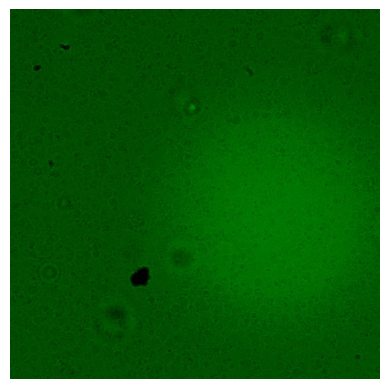

Images Name : **im2.jpg, --> Shape  (800, 800, 3)
image size: 113,082 bytes


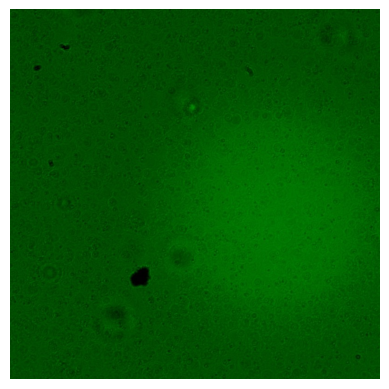

Images Name : **im3.jpg, --> Shape  (800, 800, 3)
image size: 113,031 bytes


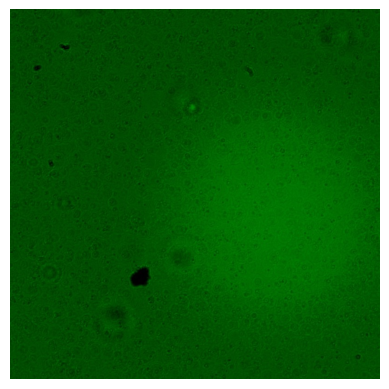

------------------------------------------------------------------------------------------------------------------------
ON Dirctory : [/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY30P100-4-fold9/1239]
Images Name : **im1.jpg, --> Shape  (800, 800, 3)
image size: 106,216 bytes


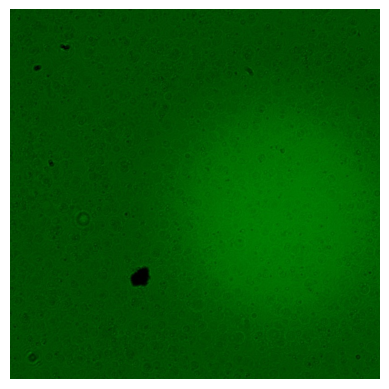

Images Name : **im2.jpg, --> Shape  (800, 800, 3)
image size: 106,073 bytes


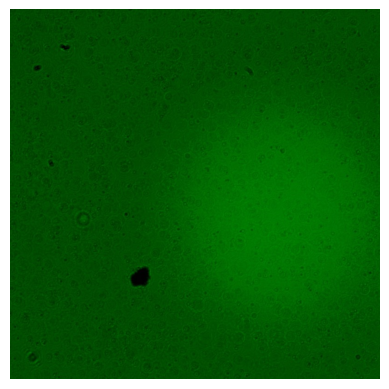

Images Name : **im3.jpg, --> Shape  (800, 800, 3)
image size: 106,101 bytes


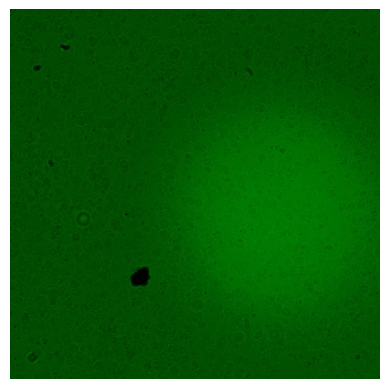

------------------------------------------------------------------------------------------------------------------------
ON Dirctory : [/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY30P100-4-fold9/1839]
Images Name : **im1.jpg, --> Shape  (800, 800, 3)
image size: 105,952 bytes


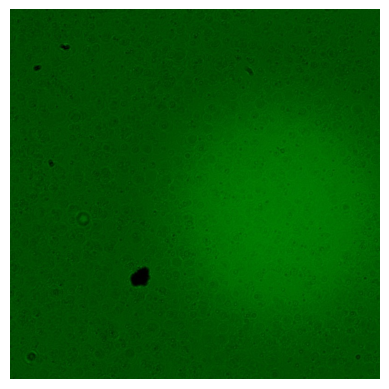

Images Name : **im2.jpg, --> Shape  (800, 800, 3)
image size: 105,861 bytes


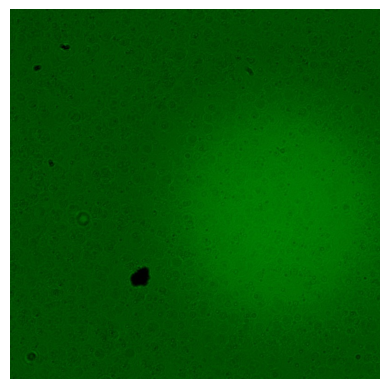

Images Name : **im3.jpg, --> Shape  (800, 800, 3)
image size: 105,887 bytes


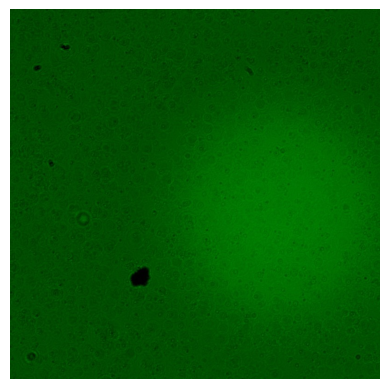

------------------------------------------------------------------------------------------------------------------------
ON Dirctory : [/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY30P100-4-fold9/39]
Images Name : **im1.jpg, --> Shape  (800, 800, 3)
image size: 105,692 bytes


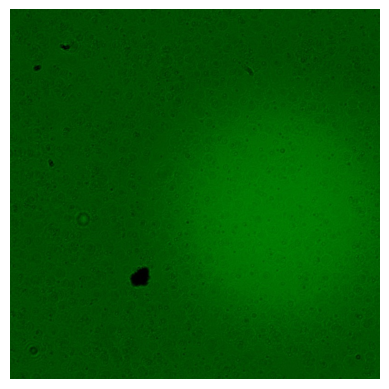

Images Name : **im2.jpg, --> Shape  (800, 800, 3)
image size: 105,809 bytes


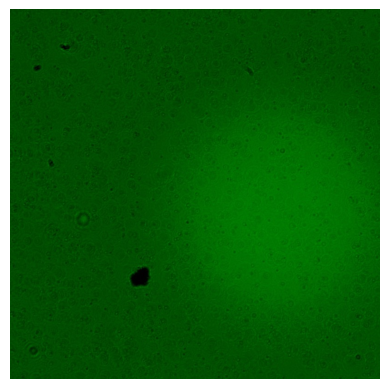

Images Name : **im3.jpg, --> Shape  (800, 800, 3)
image size: 105,671 bytes


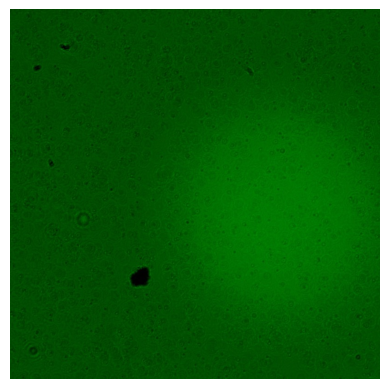

------------------------------------------------------------------------------------------------------------------------
ON Dirctory : [/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY30P100-4-fold9/1439]
Images Name : **im1.jpg, --> Shape  (800, 800, 3)
image size: 106,065 bytes


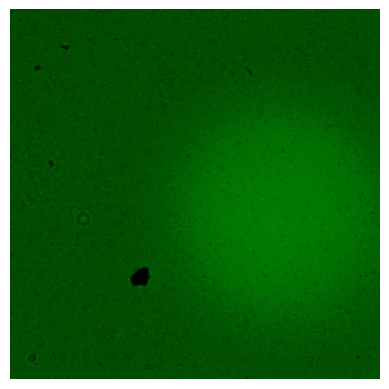

Images Name : **im2.jpg, --> Shape  (800, 800, 3)
image size: 106,202 bytes


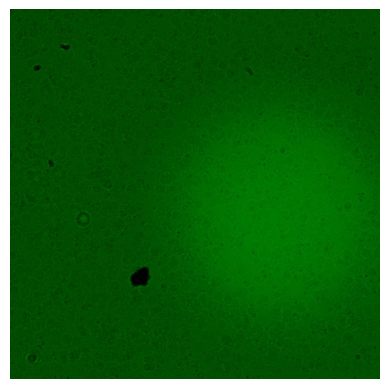

Images Name : **im3.jpg, --> Shape  (800, 800, 3)
image size: 106,005 bytes


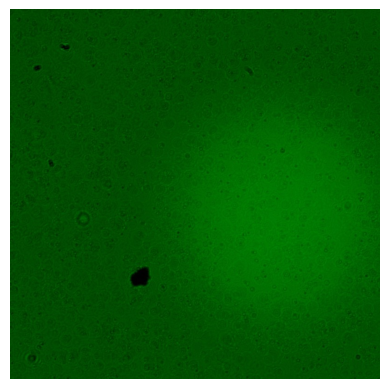

------------------------------------------------------------------------------------------------------------------------
ON Dirctory : [/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY20P100-4-fold8/1838]
Images Name : **im1.jpg, --> Shape  (800, 800, 3)
image size: 125,197 bytes


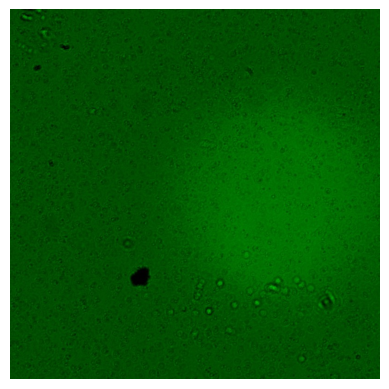

Images Name : **im2.jpg, --> Shape  (800, 800, 3)
image size: 125,204 bytes


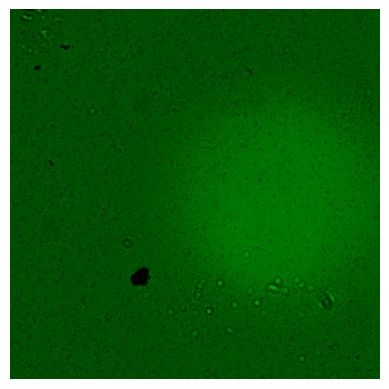

Images Name : **im3.jpg, --> Shape  (800, 800, 3)
image size: 124,990 bytes


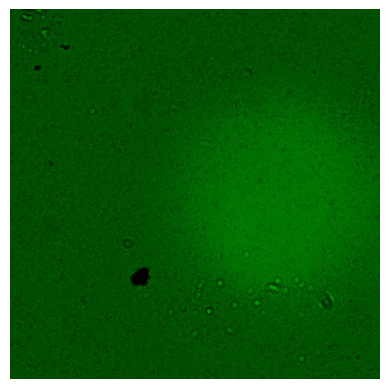

------------------------------------------------------------------------------------------------------------------------
ON Dirctory : [/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY30P100-4-fold9/839]
Images Name : **im1.jpg, --> Shape  (800, 800, 3)
image size: 105,951 bytes


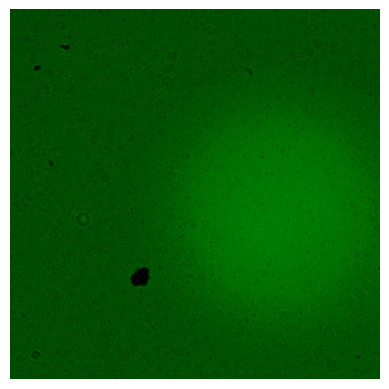

Images Name : **im2.jpg, --> Shape  (800, 800, 3)
image size: 106,025 bytes


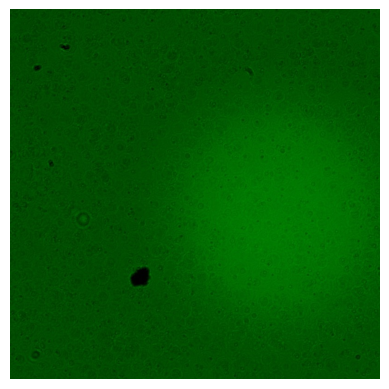

Images Name : **im3.jpg, --> Shape  (800, 800, 3)
image size: 105,882 bytes


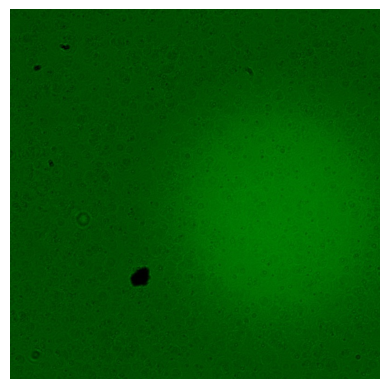

------------------------------------------------------------------------------------------------------------------------
ON Dirctory : [/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY30P100-4-fold9/439]
Images Name : **im1.jpg, --> Shape  (800, 800, 3)
image size: 105,812 bytes


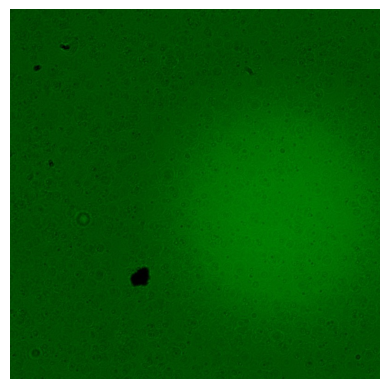

Images Name : **im2.jpg, --> Shape  (800, 800, 3)
image size: 105,864 bytes


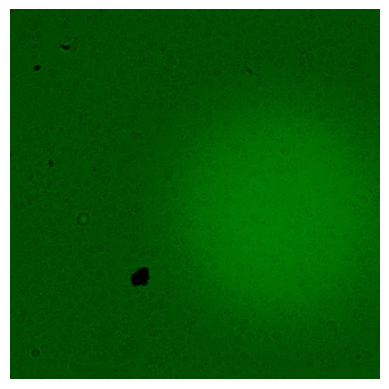

Images Name : **im3.jpg, --> Shape  (800, 800, 3)
image size: 105,927 bytes


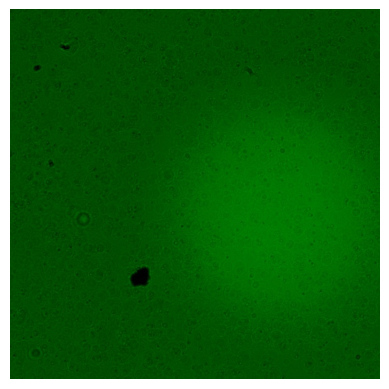

------------------------------------------------------------------------------------------------------------------------
ON Dirctory : [/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY40P100-1-fold10/1640]
Images Name : **im1.jpg, --> Shape  (800, 800, 3)
image size: 112,837 bytes


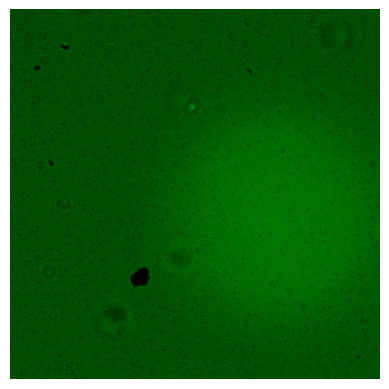

Images Name : **im2.jpg, --> Shape  (800, 800, 3)
image size: 112,982 bytes


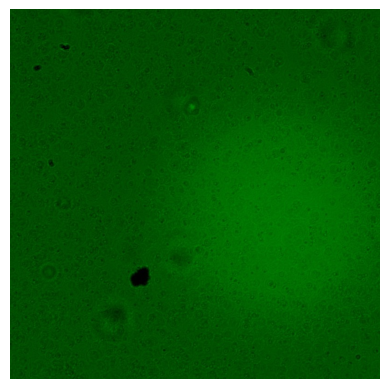

Images Name : **im3.jpg, --> Shape  (800, 800, 3)
image size: 112,630 bytes


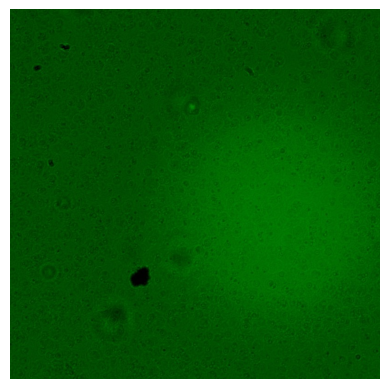

------------------------------------------------------------------------------------------------------------------------
ON Dirctory : [/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY20P100-4-fold8/1638]
Images Name : **im1.jpg, --> Shape  (800, 800, 3)
image size: 125,142 bytes


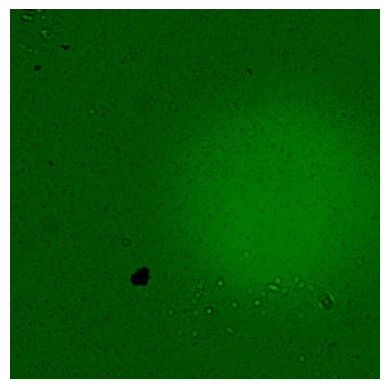

Images Name : **im2.jpg, --> Shape  (800, 800, 3)
image size: 124,953 bytes


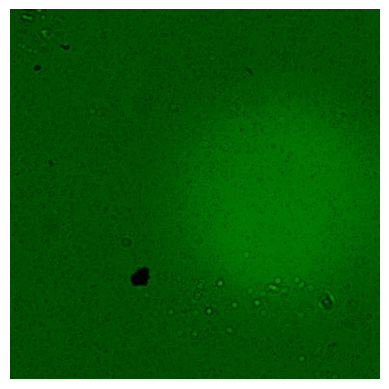

Images Name : **im3.jpg, --> Shape  (800, 800, 3)
image size: 125,170 bytes


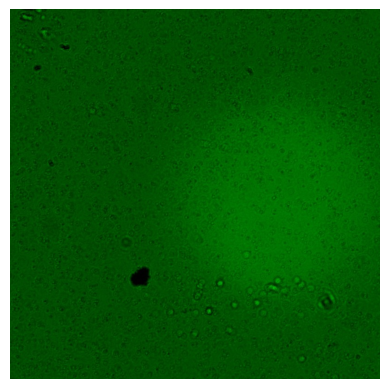

------------------------------------------------------------------------------------------------------------------------
ON Dirctory : [/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY20P100-4-fold8/1438]
Images Name : **im1.jpg, --> Shape  (800, 800, 3)
image size: 125,062 bytes


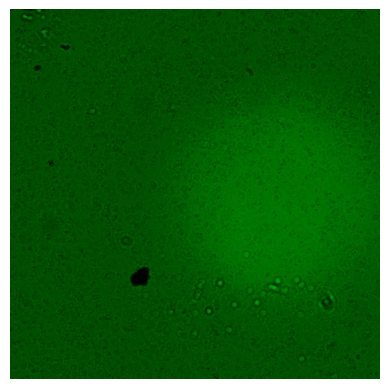

Images Name : **im2.jpg, --> Shape  (800, 800, 3)
image size: 124,935 bytes


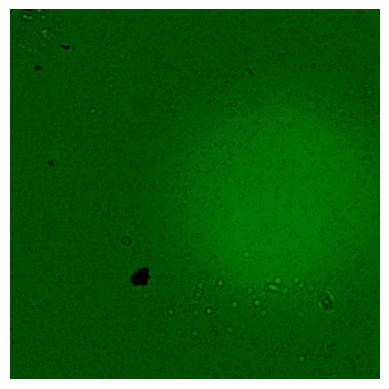

Images Name : **im3.jpg, --> Shape  (800, 800, 3)
image size: 124,672 bytes


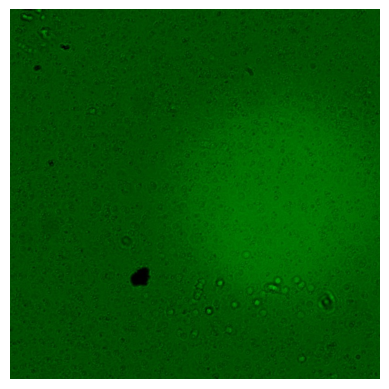

------------------------------------------------------------------------------------------------------------------------
ON Dirctory : [/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY40P100-1-fold10/440]
Images Name : **im1.jpg, --> Shape  (800, 800, 3)
image size: 112,659 bytes


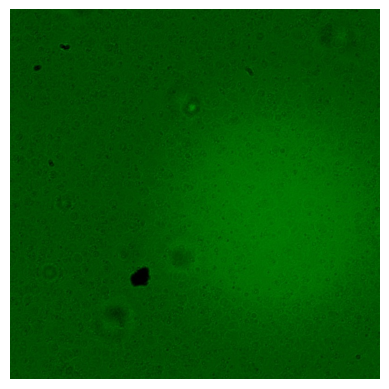

Images Name : **im2.jpg, --> Shape  (800, 800, 3)
image size: 112,651 bytes


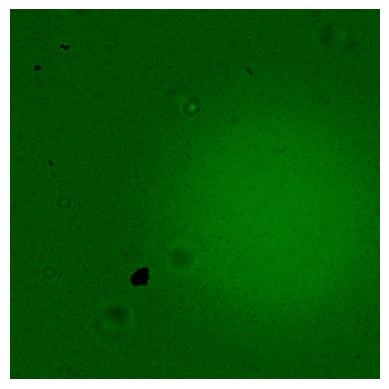

Images Name : **im3.jpg, --> Shape  (800, 800, 3)
image size: 112,656 bytes


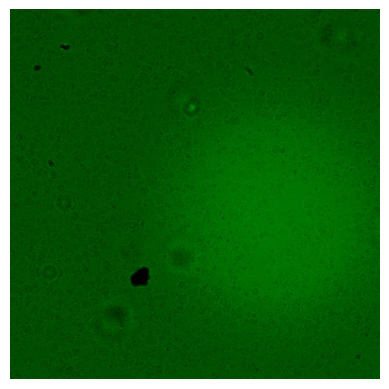

------------------------------------------------------------------------------------------------------------------------
ON Dirctory : [/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY40P100-1-fold10/640]
Images Name : **im1.jpg, --> Shape  (800, 800, 3)
image size: 112,761 bytes


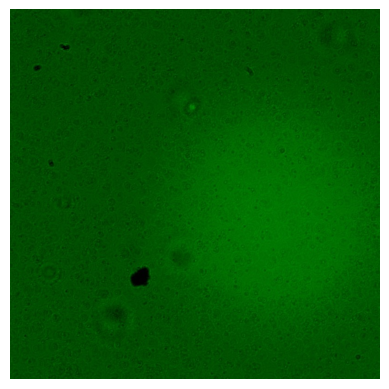

Images Name : **im2.jpg, --> Shape  (800, 800, 3)
image size: 112,893 bytes


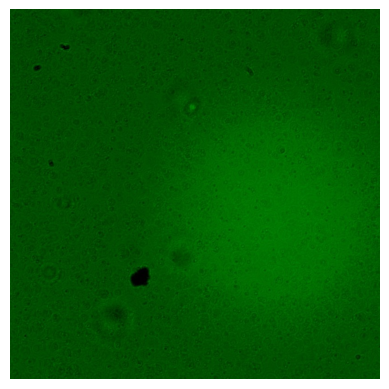

Images Name : **im3.jpg, --> Shape  (800, 800, 3)
image size: 112,890 bytes


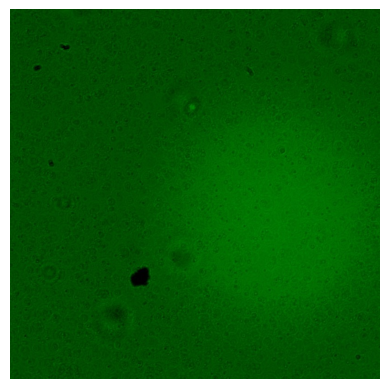

------------------------------------------------------------------------------------------------------------------------
ON Dirctory : [/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY40P100-1-fold10/840]
Images Name : **im1.jpg, --> Shape  (800, 800, 3)
image size: 112,579 bytes


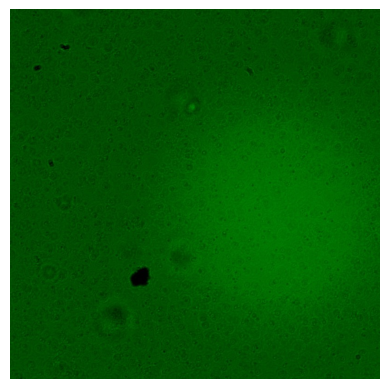

Images Name : **im2.jpg, --> Shape  (800, 800, 3)
image size: 112,753 bytes


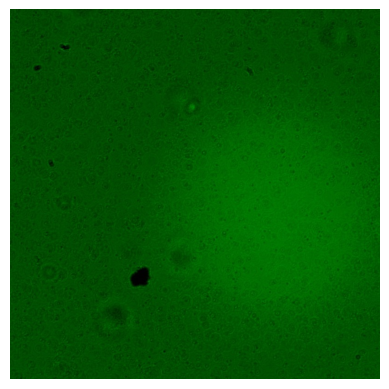

Images Name : **im3.jpg, --> Shape  (800, 800, 3)
image size: 112,683 bytes


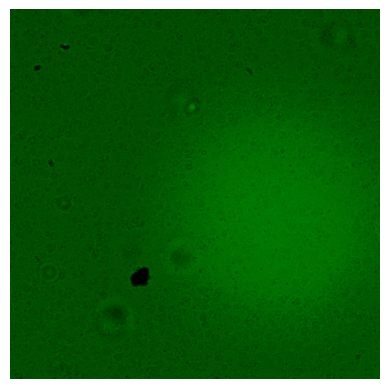

------------------------------------------------------------------------------------------------------------------------
ON Dirctory : [/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY40P100-1-fold10/1240]
Images Name : **im1.jpg, --> Shape  (800, 800, 3)
image size: 112,647 bytes


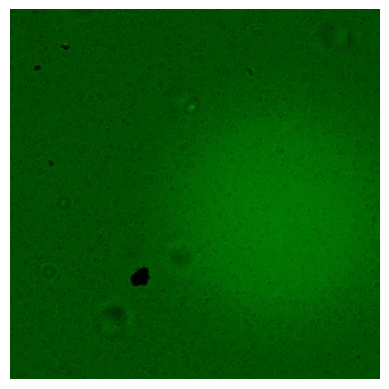

Images Name : **im2.jpg, --> Shape  (800, 800, 3)
image size: 112,756 bytes


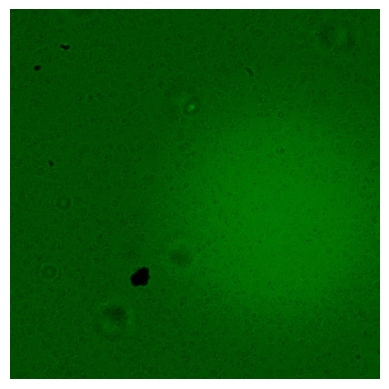

Images Name : **im3.jpg, --> Shape  (800, 800, 3)
image size: 112,578 bytes


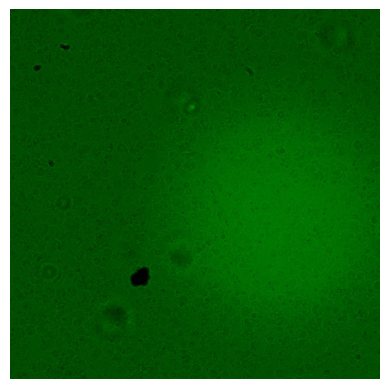

------------------------------------------------------------------------------------------------------------------------
ON Dirctory : [/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY40P100-1-fold10/1440]
Images Name : **im1.jpg, --> Shape  (800, 800, 3)
image size: 112,761 bytes


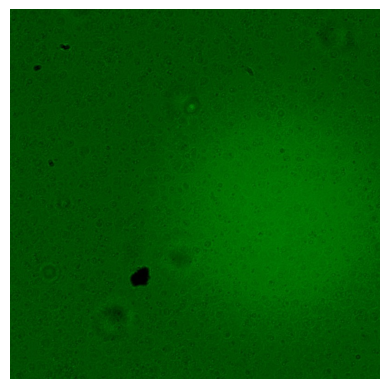

Images Name : **im2.jpg, --> Shape  (800, 800, 3)
image size: 112,893 bytes


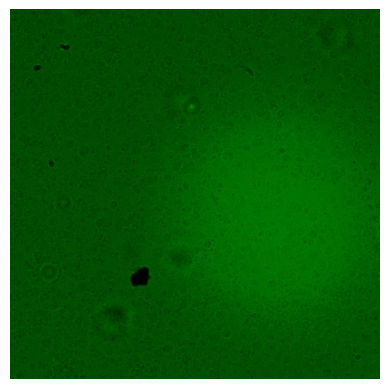

Images Name : **im3.jpg, --> Shape  (800, 800, 3)
image size: 112,904 bytes


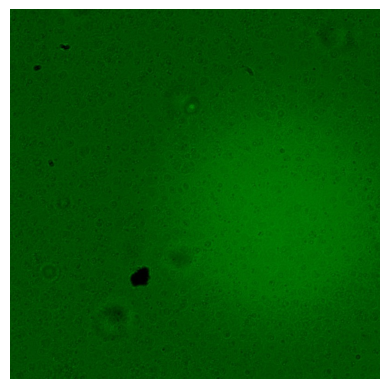

------------------------------------------------------------------------------------------------------------------------
ON Dirctory : [/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY40P100-1-fold10/1840]
Images Name : **im1.jpg, --> Shape  (800, 800, 3)
image size: 112,555 bytes


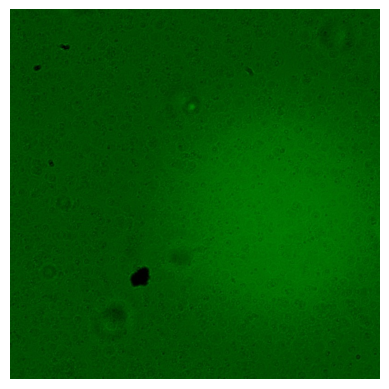

Images Name : **im2.jpg, --> Shape  (800, 800, 3)
image size: 112,287 bytes


Images Name : **im3.jpg, --> Shape  (800, 800, 3)
image size: 112,435 bytes


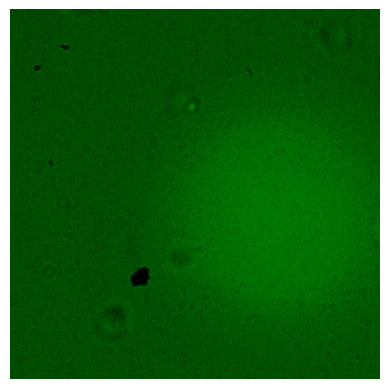

------------------------------------------------------------------------------------------------------------------------
ON Dirctory : [/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY30P100-4-fold9/1039]
Images Name : **im1.jpg, --> Shape  (800, 800, 3)
image size: 105,934 bytes


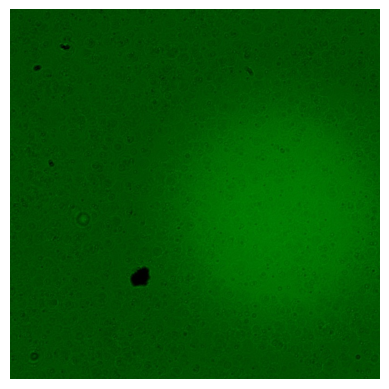

Images Name : **im2.jpg, --> Shape  (800, 800, 3)
image size: 106,028 bytes


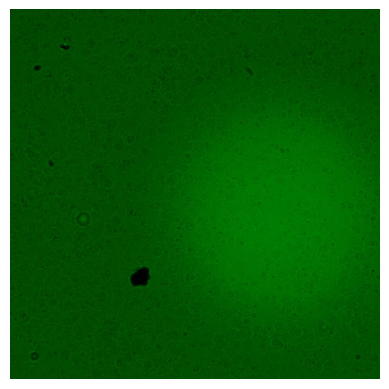

Images Name : **im3.jpg, --> Shape  (800, 800, 3)
image size: 105,983 bytes


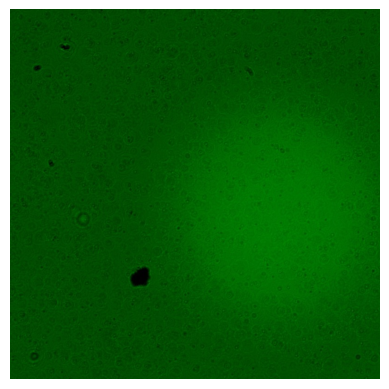

------------------------------------------------------------------------------------------------------------------------
ON Dirctory : [/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY30P100-4-fold9/1639]
Images Name : **im1.jpg, --> Shape  (800, 800, 3)
image size: 106,131 bytes


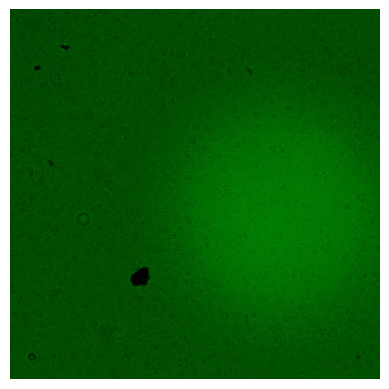

Images Name : **im2.jpg, --> Shape  (800, 800, 3)
image size: 105,858 bytes


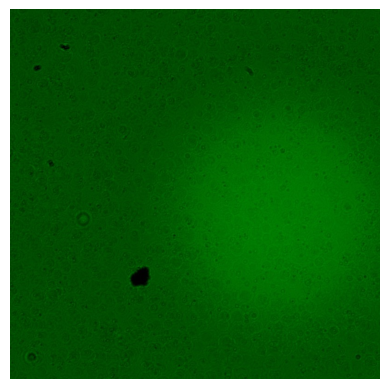

Images Name : **im3.jpg, --> Shape  (800, 800, 3)
image size: 105,952 bytes


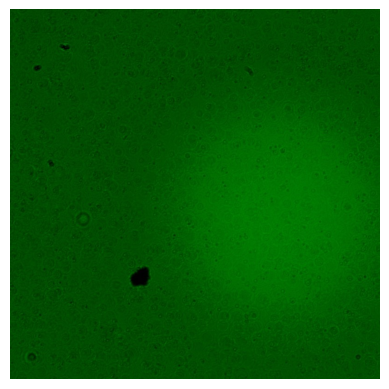

------------------------------------------------------------------------------------------------------------------------
ON Dirctory : [/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY30P100-4-fold9/639]
Images Name : **im1.jpg, --> Shape  (800, 800, 3)
image size: 106,042 bytes


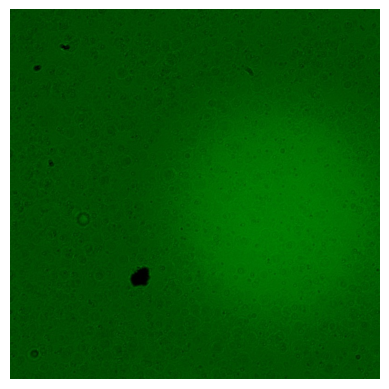

Images Name : **im2.jpg, --> Shape  (800, 800, 3)
image size: 105,728 bytes


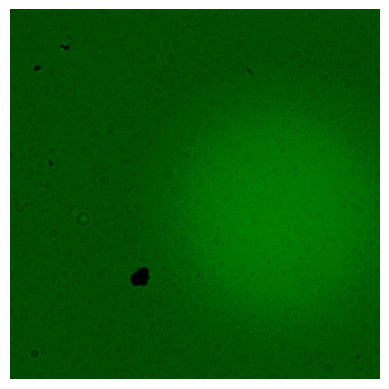

Images Name : **im3.jpg, --> Shape  (800, 800, 3)
image size: 106,015 bytes


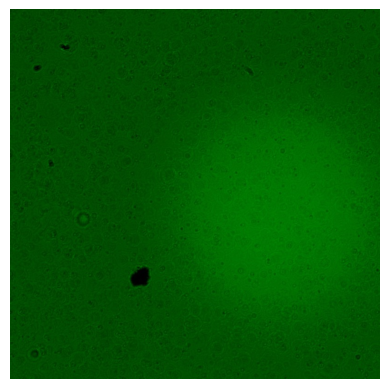

------------------------------------------------------------------------------------------------------------------------
ON Dirctory : [/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY30P100-4-fold9/239]
Images Name : **im1.jpg, --> Shape  (800, 800, 3)
image size: 105,938 bytes


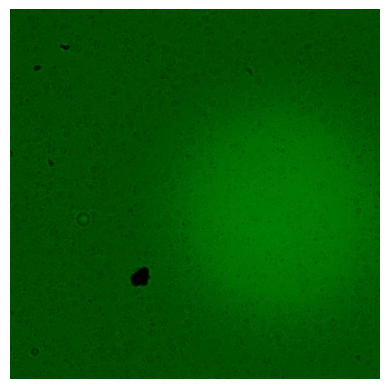

Images Name : **im2.jpg, --> Shape  (800, 800, 3)
image size: 105,765 bytes


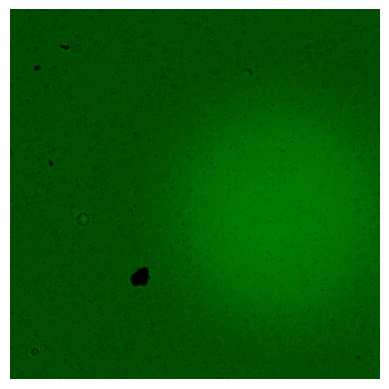

Images Name : **im3.jpg, --> Shape  (800, 800, 3)
image size: 105,750 bytes


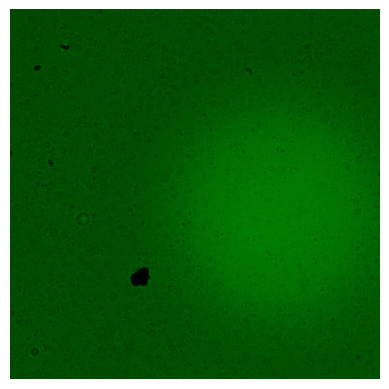

------------------------------------------------------------------------------------------------------------------------
ON Dirctory : [/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY40P100-1-fold10/40]
Images Name : **im1.jpg, --> Shape  (800, 800, 3)
image size: 112,996 bytes


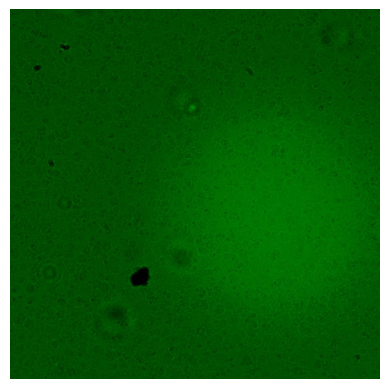

Images Name : **im2.jpg, --> Shape  (800, 800, 3)
image size: 113,086 bytes


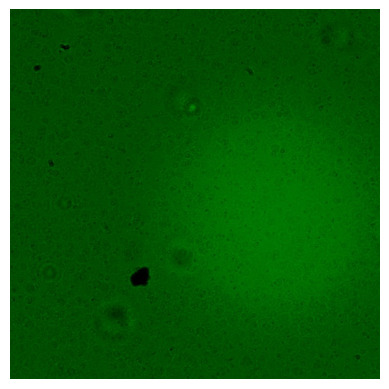

Images Name : **im3.jpg, --> Shape  (800, 800, 3)
image size: 112,965 bytes


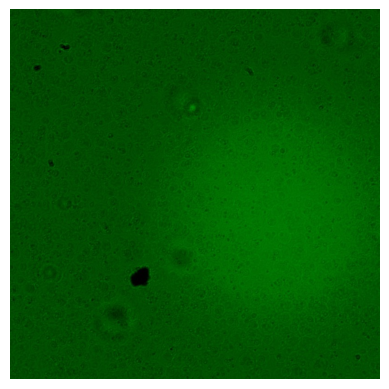

------------------------------------------------------------------------------------------------------------------------
ON Dirctory : [/media/SSD/rheology_data/Glycerol-water-mixtures-train/GLY40P100-1-fold10/1040]
Images Name : **im1.jpg, --> Shape  (800, 800, 3)
image size: 112,647 bytes


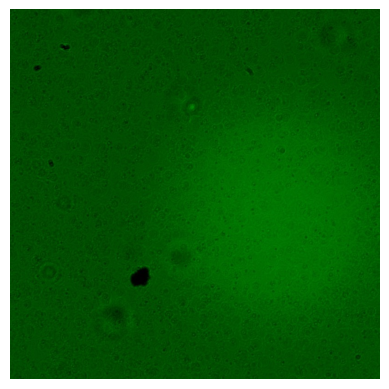

Images Name : **im2.jpg, --> Shape  (800, 800, 3)
image size: 112,715 bytes


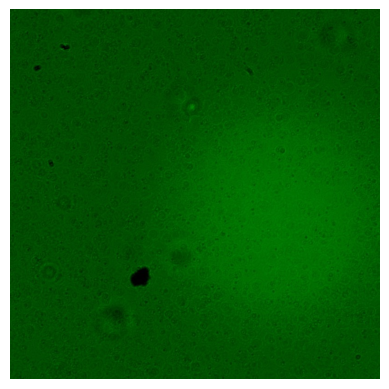

Images Name : **im3.jpg, --> Shape  (800, 800, 3)
image size: 112,715 bytes


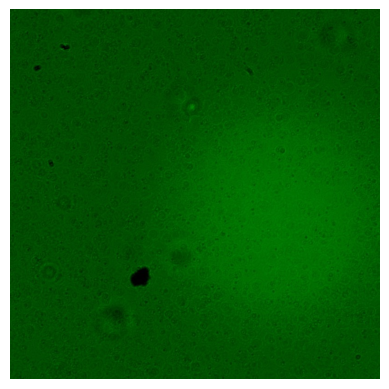

------------------------------------------------------------------------------------------------------------------------


In [91]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import cv2
import os
import random

for i in range(len(lst_occ)):
    ims = sorted(glob.glob(f'{lst_occ[i]}/*.jpg'))
    print(f'ON Dirctory : [{lst_occ[i]}]')
    for im in ims:
        #print(im)
        name_im = im.split('/')[-1]
        #print(name_im)
        image = cv2.imread(im)
        sZ = os.path.getsize(im)
        print(f"Images Name : **{name_im}, --> Shape ", image.shape)
        print(f"image size: {sZ:,} bytes")
        plt.axis("off")
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        plt.show()
    print('-'*120)

## Tensorflow: Error when trying transfer learning: Invalid JPEG data or crop window

In [15]:
from struct import unpack
from tqdm import tqdm
import os


marker_mapping = {
    0xffd8: "Start of Image",
    0xffe0: "Application Default Header",
    0xffdb: "Quantization Table",
    0xffc0: "Start of Frame",
    0xffc4: "Define Huffman Table",
    0xffda: "Start of Scan",
    0xffd9: "End of Image"
}


class JPEG:
    def __init__(self, image_file):
        with open(image_file, 'rb') as f:
            self.img_data = f.read()
    
    def decode(self):
        data = self.img_data
        while(True):
            marker, = unpack(">H", data[0:2])
            # print(marker_mapping.get(marker))
            if marker == 0xffd8:
                data = data[2:]
            elif marker == 0xffd9:
                return
            elif marker == 0xffda:
                data = data[-2:]
            else:
                lenchunk, = unpack(">H", data[2:4])
                data = data[2+lenchunk:]            
            if len(data)==0:
                break        

In [10]:
bads = []

for i in range(len(data_list_)):
    images = sorted(glob.glob(f'{data_list_[i]}/*.jpg'))
    for img in tqdm(images):
#         print(img)
        #image = osp.join(root_img,img)
        image = JPEG(img) 
        try:
            image.decode()   
        except:
            bads.append(img)

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 2074.33it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1410.80it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1657.61it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1646.12it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1738.93it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1401.37it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1584.55it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1438.70it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1500.65it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1709.87it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1562.71it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1797.30it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1256.91it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1571.10it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1284.63it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1824.40it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1289.50it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1577.20it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1281.36it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1603.33it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1172.90it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1601.69it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1391.45it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1692.16it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1574.83it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1645.90it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1541.83it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1671.93it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1395.16it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1675.26it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1454.84it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1900.17it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1406.07it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1653.47it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1529.28it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1691.48it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1833.44it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1248.80it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1869.95it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1408.27it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1903.91it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1282.01it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1585.55it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1292.68it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1731.99it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1289.76it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1612.57it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1266.65it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1598.64it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1280.96it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1693.07it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1489.28it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1635.63it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1477.56it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 2101.00it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1323.40it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1671.26it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1461.94it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1673.26it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1333.36it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1638.40it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1654.34it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1643.75it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1466.88it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1572.67it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1495.12it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1047.09it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1476.52it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1535.44it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1554.79it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1267.42it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1321.46it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1224.73it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1387.77it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1477.91it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1473.58it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1552.87it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1413.49it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1358.55it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1766.52it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1683.78it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 2417.47it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1137.28it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1429.71it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1381.07it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1638.61it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1524.46it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1340.60it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1238.35it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1291.61it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1414.13it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1794.74it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1804.78it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1162.29it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1497.61it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1467.39it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 2592.28it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 2105.22it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1346.63it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1320.35it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1274.48it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1539.01it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1688.30it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1503.33it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1205.95it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1490.69it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1456.52it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1513.28it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1522.07it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1415.88it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1547.14it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 2088.45it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1588.55it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 2151.29it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1179.94it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1801.16it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1537.31it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1490.34it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1590.36it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1438.38it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1877.49it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1335.48it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1518.03it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1633.51it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1877.49it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1417.63it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1818.34it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1818.34it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1469.45it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1524.09it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1356.36it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 2629.11it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1718.04it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1262.84it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1457.03it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1725.34it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1231.33it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1436.73it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1688.30it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1273.83it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1665.73it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1641.18it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1381.37it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1636.91it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1590.96it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1905.64it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1266.14it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1485.24it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1468.25it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1283.32it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1692.16it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1433.62it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1320.62it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1554.02it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1615.89it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1284.23it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1598.24it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1866.90it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1319.10it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 2148.35it/s]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 1902.75it/s]


In [6]:
# for name in bads:
#    os.remove(osp.join(root_img,name))

In [11]:
print(len(bads))
bads

0


[]

In [12]:
image.decode() 

In [13]:
image

In [14]:
JPEG

__main__.JPEG

In [ ]:
# 'x0': tf.io.decode_image(features['frame_0/encoded'], dtype=tf.float32),
# 'x1': tf.io.decode_image(features['frame_2/encoded'], dtype=tf.float32),
# 'y': tf.io.decode_image(features['frame_1/encoded'], dtype=tf.float32),

In [16]:
tfImg_path_pass, tfImg_path_corru = [], []
features_pass, features_corrupted = [], []
train_files = sorted(glob.glob('/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/*'))
for output_path in train_files:
    filenames = [output_path]
    raw_dataset = tf.data.TFRecordDataset(filenames)
    parsed_dataset = raw_dataset.map(_parse_function)
    for image_features in parsed_dataset:
        try:
            x0 = tf.io.decode_image(image_features['frame_0/encoded'], dtype=tf.float32)
            x1 = tf.io.decode_image(image_features['frame_2/encoded'], dtype=tf.float32)
            y = tf.io.decode_image(image_features['frame_1/encoded'], dtype=tf.float32)
            #print(x0)
            features_pass.append(image_features)
            tfImg_path_pass.append(output_path)
            #print(image_raw_)
        except Exception as e:
            features_corrupted.append(image_features)
            tfImg_path_corru.append(output_path)
            print("{} is corrupted".format(output_path))
            print(e)
    print(f"Read TFRecoeds Dataset : [{output_path}]")

Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00000-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00001-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00002-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00003-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00004-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00005-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00006-of-00200]
Read TFRecoed

Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00059-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00060-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00061-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00062-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00063-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00064-of-00200]
/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00065-of-00200 is corrupted
jpeg::Uncompress failed. In

Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00116-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00117-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00118-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00119-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00120-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00121-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00122-of-00200]
Read TFRecoed

Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00173-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00174-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00175-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00176-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00177-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00178-of-00200]
Read TFRecoeds Dataset : [/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00179-of-00200]
Read TFRecoed

In [17]:
print('>>> jpeg::Uncompress failed. Invalid JPEG data or crop window. [Op:DecodeImage] <<<')
print(f'Number of features [ {len(features_corrupted)} ]')
print(f'Number of Images path [ {len(tfImg_path_corru)} ]')

>>> jpeg::Uncompress failed. Invalid JPEG data or crop window. [Op:DecodeImage] <<<
Number of features [ 2 ]
Number of Images path [ 2 ]


In [18]:
features_corrupted[0]

{'frame_0/encoded': <tf.Tensor: shape=(), dtype=string, numpy=b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00\x00H\x00H\x00\x00\xff\xe1\x00@Exif\x00\x00MM\x00*\x00\x00\x00\x08\x00\x01\x87i\x00\x04\x00\x00\x00\x01\x00\x00\x00\x1a\x00\x00\x00\x00\x00\x02\xa0\x02\x00\x04\x00\x00\x00\x01\x00\x00\x03 \xa0\x03\x00\x04\x00\x00\x00\x01\x00\x00\x03 \x00\x00\x00\x00\xff\xc0\x00\x11\x08\x03 \x03 \x03\x01"\x00\x02\x11\x01\x03\x11\x01\xff\xc4\x00\x1f\x00\x00\x01\x05\x01\x01\x01\x01\x01\x01\x00\x00\x00\x00\x00\x00\x00\x00\x01\x02\x03\x04\x05\x06\x07\x08\t\n\x0b\xff\xc4\x00\xb5\x10\x00\x02\x01\x03\x03\x02\x04\x03\x05\x05\x04\x04\x00\x00\x01}\x01\x02\x03\x00\x04\x11\x05\x12!1A\x06\x13Qa\x07"q\x142\x81\x91\xa1\x08#B\xb1\xc1\x15R\xd1\xf0$3br\x82\t\n\x16\x17\x18\x19\x1a%&\'()*456789:CDEFGHIJSTUVWXYZcdefghijstuvwxyz\x83\x84\x85\x86\x87\x88\x89\x8a\x92\x93\x94\x95\x96\x97\x98\x99\x9a\xa2\xa3\xa4\xa5\xa6\xa7\xa8\xa9\xaa\xb2\xb3\xb4\xb5\xb6\xb7\xb8\xb9\xba\xc2\xc3\xc4\xc5\xc6\xc7\xc8\xc9\xca\xd2\xd3\xd4\xd5\x

In [19]:
features_corrupted[1]

{'frame_0/encoded': <tf.Tensor: shape=(), dtype=string, numpy=b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00\x00H\x00H\x00\x00\xff\xe1\x00@Exif\x00\x00MM\x00*\x00\x00\x00\x08\x00\x01\x87i\x00\x04\x00\x00\x00\x01\x00\x00\x00\x1a\x00\x00\x00\x00\x00\x02\xa0\x02\x00\x04\x00\x00\x00\x01\x00\x00\x03 \xa0\x03\x00\x04\x00\x00\x00\x01\x00\x00\x03 \x00\x00\x00\x00\xff\xc0\x00\x11\x08\x03 \x03 \x03\x01"\x00\x02\x11\x01\x03\x11\x01\xff\xc4\x00\x1f\x00\x00\x01\x05\x01\x01\x01\x01\x01\x01\x00\x00\x00\x00\x00\x00\x00\x00\x01\x02\x03\x04\x05\x06\x07\x08\t\n\x0b\xff\xc4\x00\xb5\x10\x00\x02\x01\x03\x03\x02\x04\x03\x05\x05\x04\x04\x00\x00\x01}\x01\x02\x03\x00\x04\x11\x05\x12!1A\x06\x13Qa\x07"q\x142\x81\x91\xa1\x08#B\xb1\xc1\x15R\xd1\xf0$3br\x82\t\n\x16\x17\x18\x19\x1a%&\'()*456789:CDEFGHIJSTUVWXYZcdefghijstuvwxyz\x83\x84\x85\x86\x87\x88\x89\x8a\x92\x93\x94\x95\x96\x97\x98\x99\x9a\xa2\xa3\xa4\xa5\xa6\xa7\xa8\xa9\xaa\xb2\xb3\xb4\xb5\xb6\xb7\xb8\xb9\xba\xc2\xc3\xc4\xc5\xc6\xc7\xc8\xc9\xca\xd2\xd3\xd4\xd5\x

In [20]:
tfImg_path_corru

['/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00065-of-00200',
 '/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00135-of-00200']

## *-- Remove--*

['/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00065-of-00200',

 '/media/SSD/DATA_FILM/Glycerol-water-mixtures-TFRecord/GLY10P100-2-fold1/GLY10P100-2-fold1.tfrecord-00135-of-00200']
 

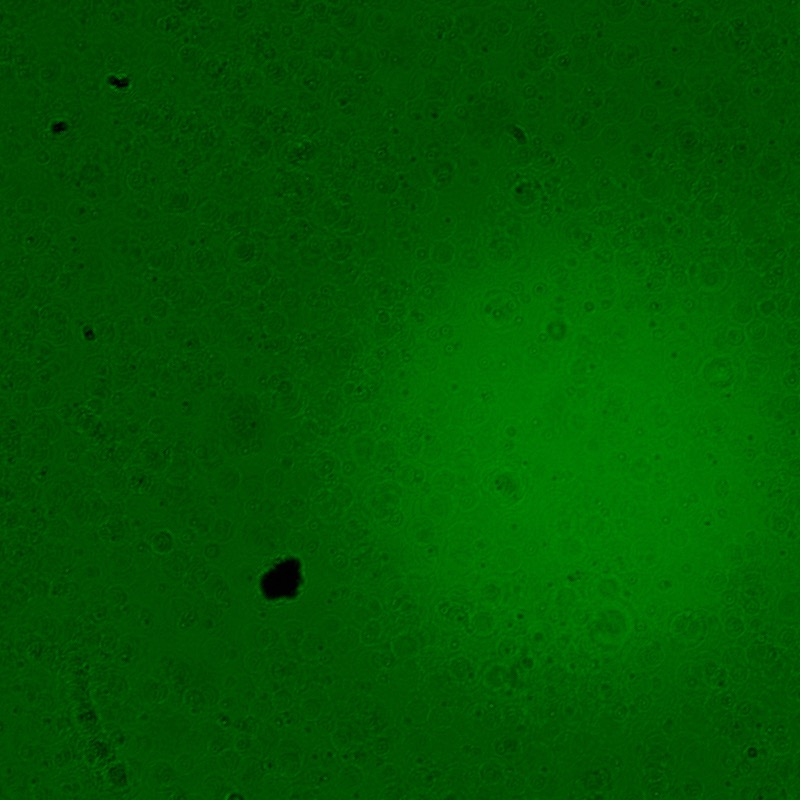

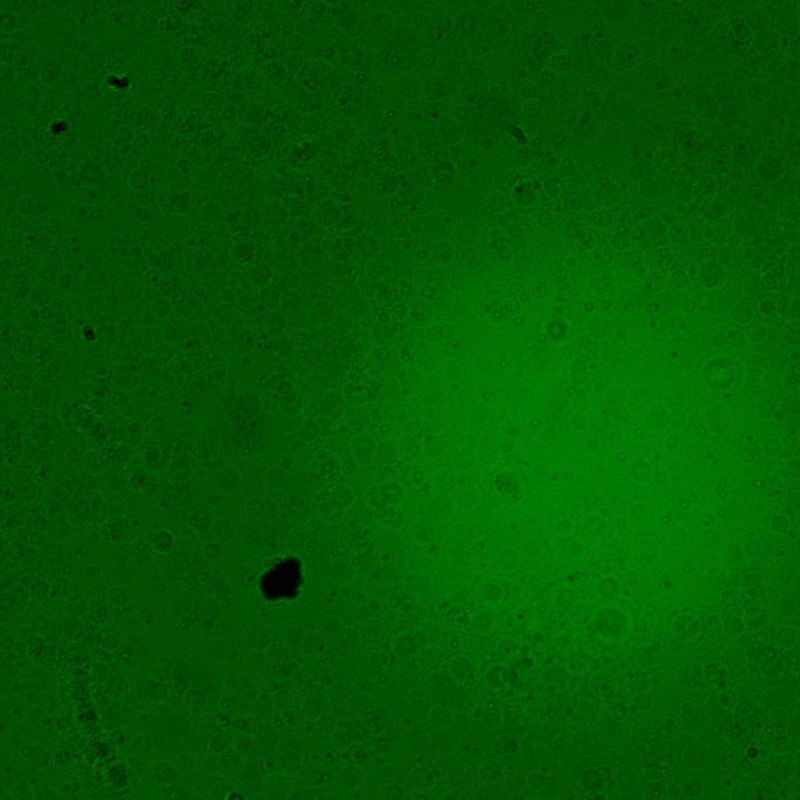

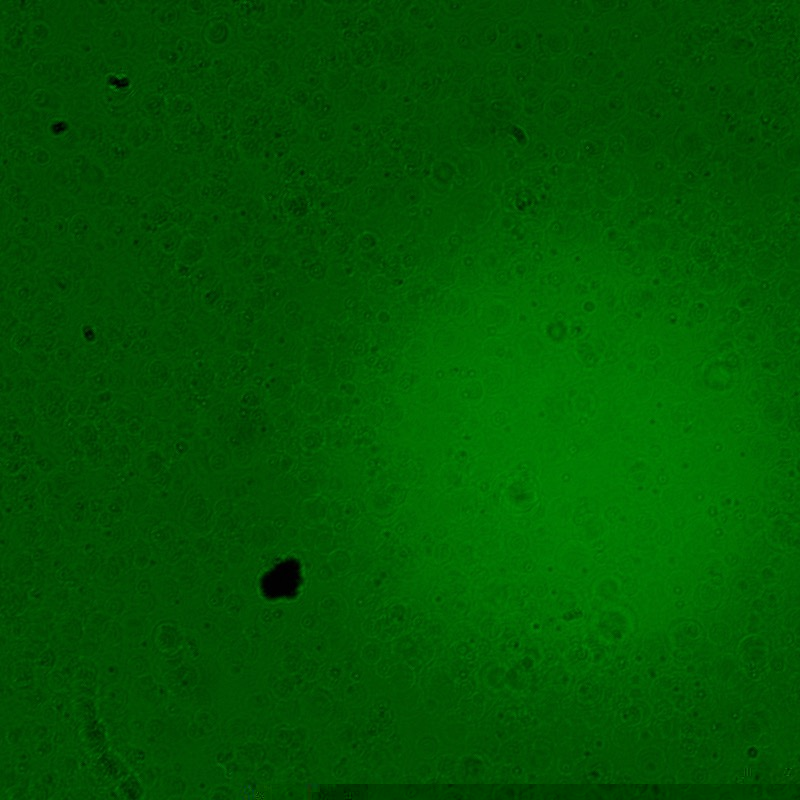

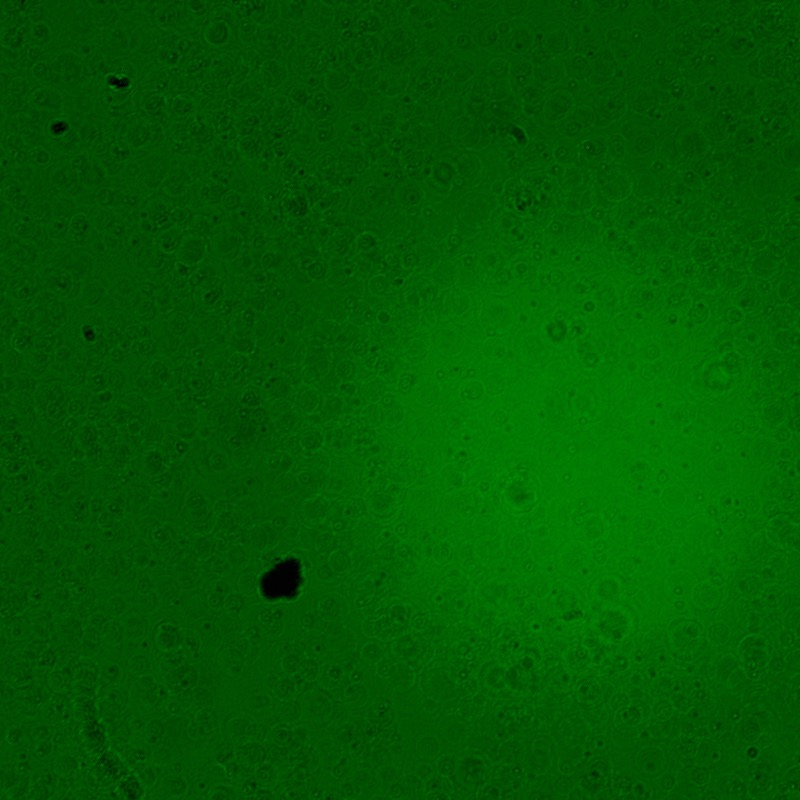

In [22]:
import IPython.display as display

img_all = []
for fea in features_corrupted:
    x0_img = fea['frame_0/encoded'].numpy()
    img_all.append(x0_img)
    x1_img = fea['frame_2/encoded'].numpy()
    img_all.append(x1_img)
    y_img = fea['frame_1/encoded'].numpy()
    img_all.append(y_img)
for im in img_all:
    display.display(display.Image(data=im))